In [1]:
import pandas as pd
import numpy as np
import seaborn as sns

%matplotlib inline

In [2]:
df = pd.read_csv('../Behavior Cloning/data/driving_log.csv')

Driving Log:
Total number of images: 48433
Total number of images that steering == 0: 25534


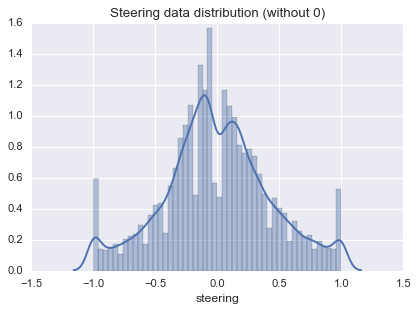

In [3]:
print("Driving Log:")
print("Total number of images: {}".format(len(df)))
print("Total number of images that steering == 0: {}".format((df.steering == 0).sum()))
df_n0 = df[df.steering != 0]
sns.plt.title("Steering data distribution (without 0)")
sns.distplot(df_n0.steering)
sns.plt.show()


Randomly choose 20 center images that the corresponding steering angle is in the specified range.
随机挑选并显示20张指定steering区间的对应center图片


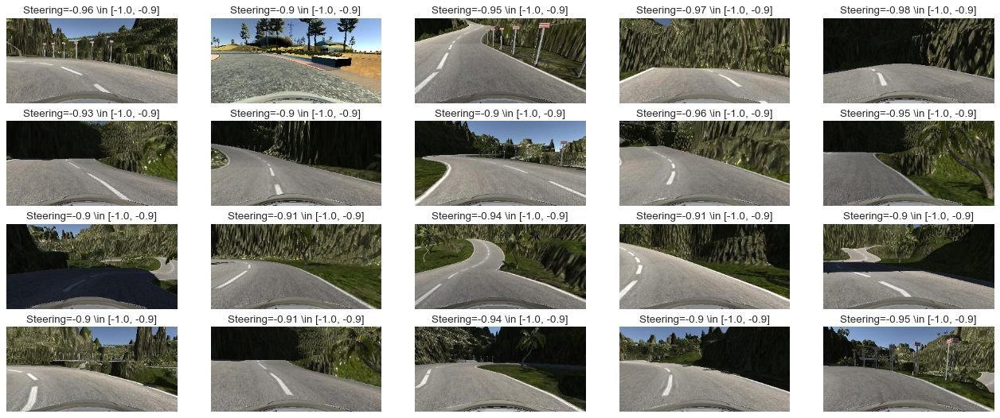

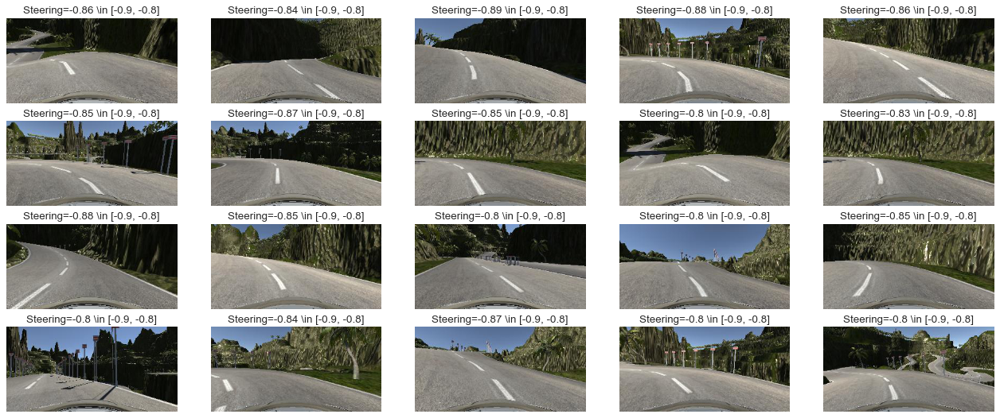

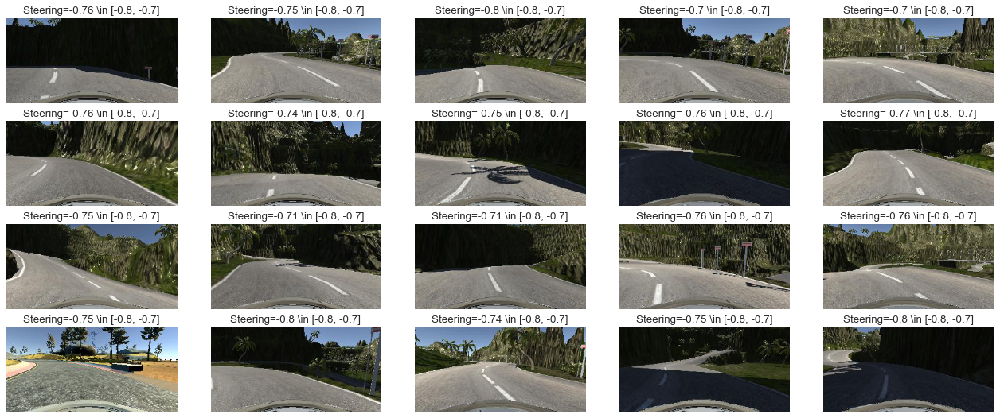

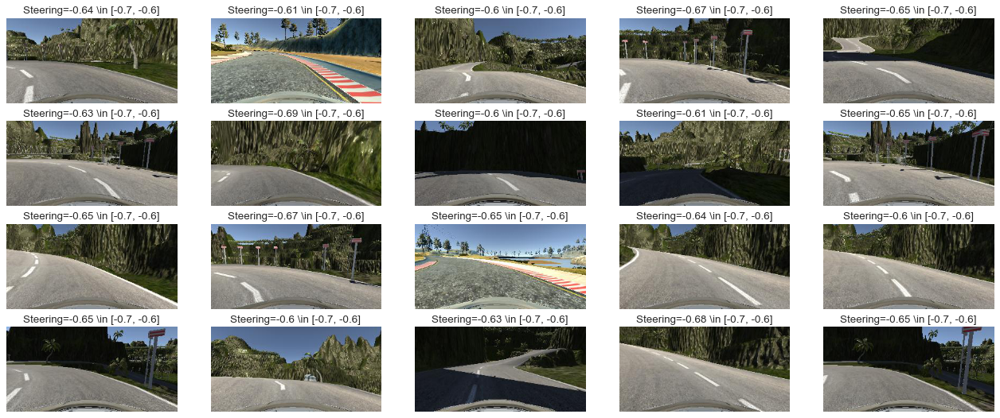

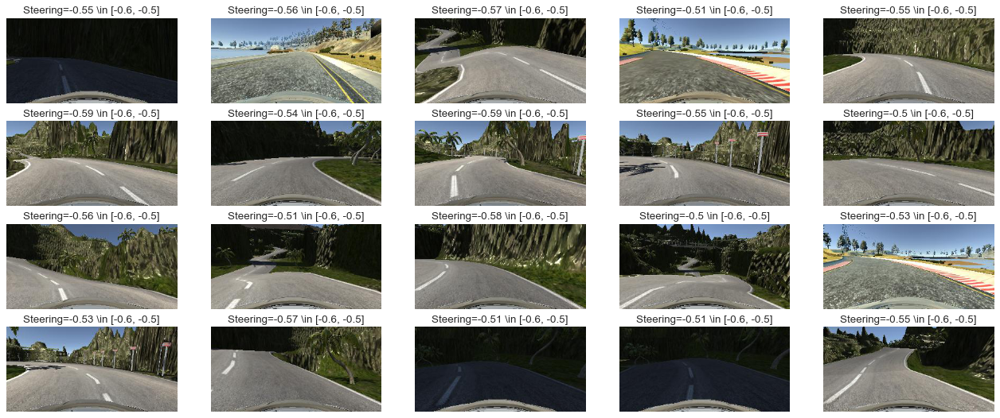

...

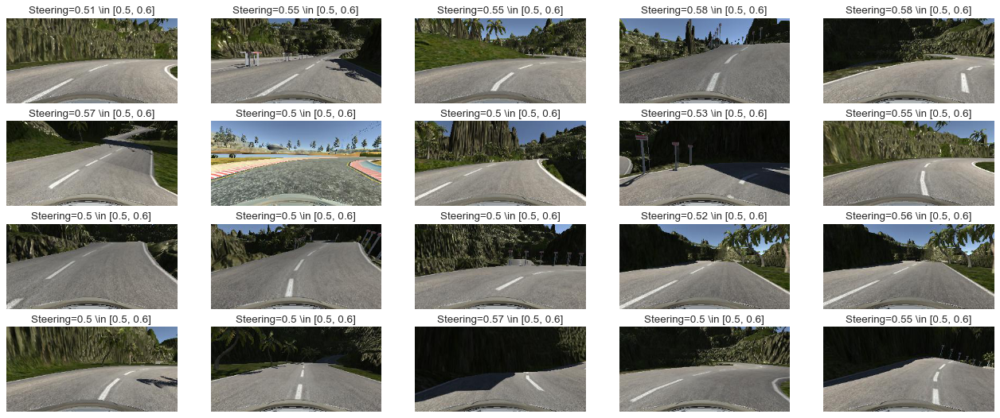

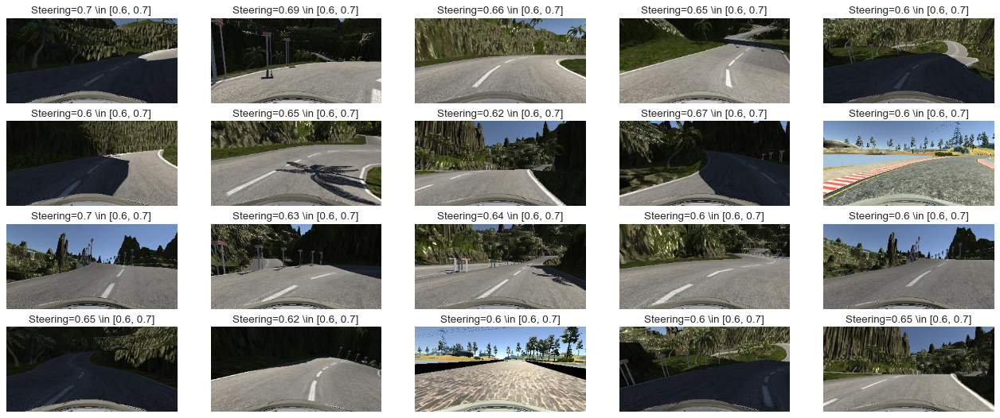

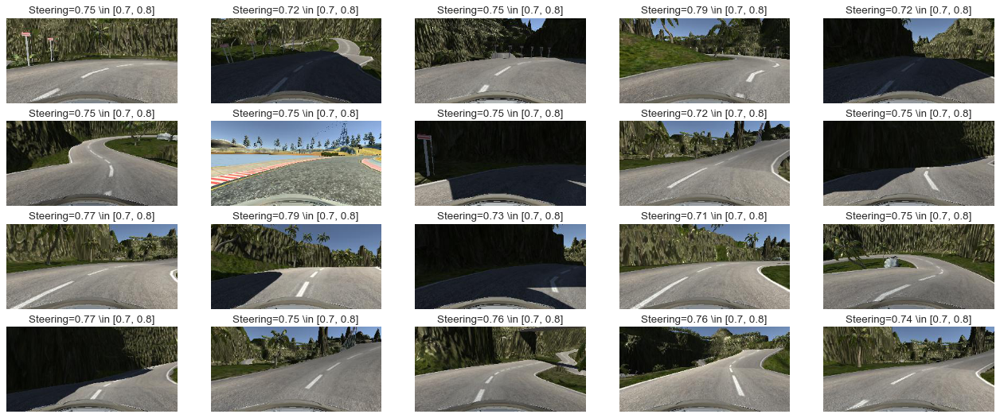

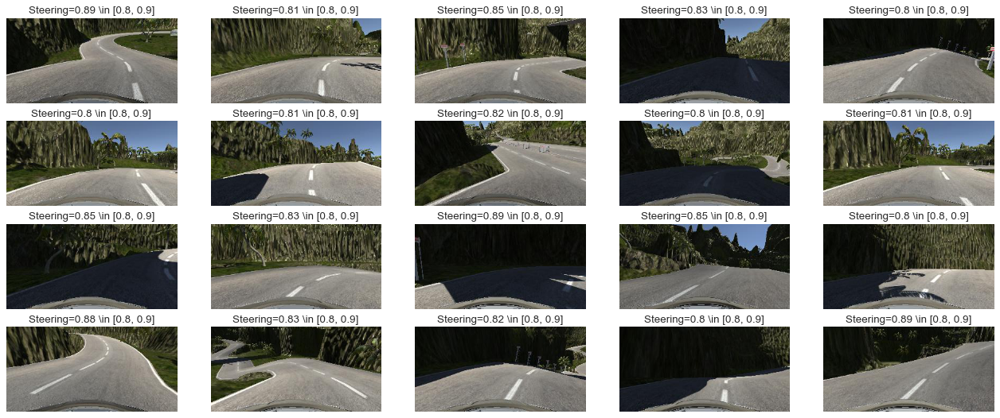

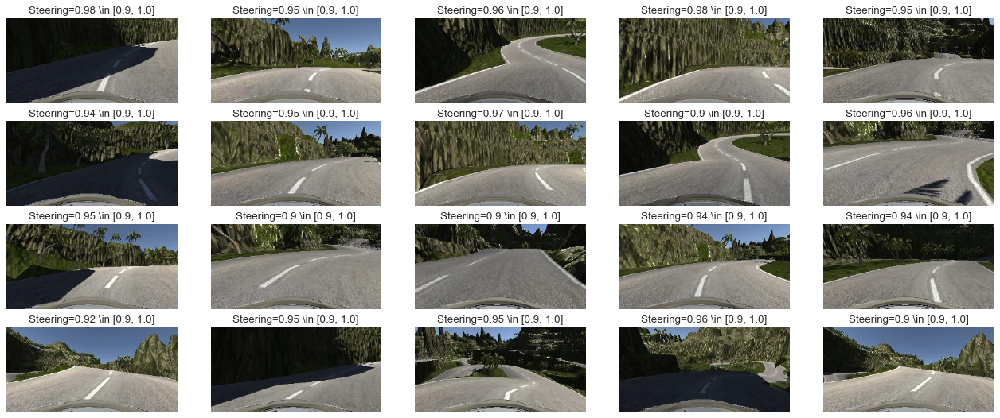

In [11]:
from random import shuffle
print("Randomly choose 20 center images that the corresponding steering angle is in the specified range.")
print("随机挑选并显示20张指定steering区间的对应center图片")
def show_steer_range(left, right):
    root_path = '../Behavior Cloning/data/'
    steer = df_n0.steering
    data = steer[(steer > left) & (steer < right)]
    images_path = df.loc[data.index, ('center', 'steering')]
    images_path, steering = images_path.center, images_path.steering
    def get_path(x):
        x = x.split('/')[-1]
        x = x.split('\\')[-1]
        return root_path + 'IMG/' + x
    images_path = images_path.map(get_path)
    images_path = list(zip(images_path.values, steering.values))
    shuffle(images_path)
    images_path = images_path[:20]
    figure = sns.plt.figure(figsize=(20, 8))
    for i, (image_path, true_steering) in enumerate(images_path):
        ax = sns.plt.subplot(4, 5, i + 1)
        ax.set_xticks([])  
        ax.set_yticks([])  
        sns.plt.title("Steering={:.2} \in [{:.2}, {:.2}]".format(true_steering, left, right))
        sns.plt.imshow(sns.plt.imread(image_path))

for i in range(20):
    left = i / 10 - 1
    right = i / 10 - 0.9
    show_steer_range(left, right)